# Trajectory analysis by SCENIC+

In [ ]:
import scanpy as sc, anndata as ad, numpy as np, pandas as pd
from anndata import AnnData
from typing import Optional, Tuple, Dict
np.random.seed(5)
%matplotlib inline
# Set out directory
outDir = '/Users/jinhuixin/Master/thesis/GRN/BS1140/traj'

In [ ]:
# load data
import dill
infile = open('/Users/jinhuixin/Master/thesis/GRN/BS1140/scenicplus/scplus_obj.pkl', 'rb')
scplus_obj = dill.load(infile)
infile.close()

In [ ]:
# Create annadata from AUC matrix (use both gene and region-based cistromes)
import anndata
auc_key = 'eRegulon_AUC'
signature_keys = ['Gene_based', 'Region_based']
data_mat = pd.concat([scplus_obj.uns[auc_key][x].T for x in signature_keys])
selected_regulons = [x for x in data_mat.index if '+_+' in x or '-_+' in x]
data_mat = data_mat.loc[selected_regulons]
adata = anndata.AnnData(X=data_mat.T.copy())
adata.obs = scplus_obj.metadata_cell.copy()

/var/folders/73/t_19bmpd5m7bnvd_88sxp6lw0000gn/T/ipykernel_78579/688199161.py:9: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(X=data_mat.T.copy())


__keep all cells__

In [ ]:
# Select variable eRegulons
sc.pp.highly_variable_genes(adata=adata, flavor='seurat', n_top_genes=200)

/Users/jinhuixin/miniconda3/envs/traj_sp_sc/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:237: RuntimeWarning: invalid value encountered in divide
  df['dispersions_norm'] = (


Generate embedding and cluster

In [ ]:
# Make PCA
sc.tl.pca(adata)
# Neighbors and clustering
sc.pp.neighbors(adata, use_rep='X_pca')
sc.tl.leiden(adata, resolution = 1)
# Diffusion map
sc.tl.diffmap(adata, random_state=5)

add TF expression to the anndata object

In [ ]:
import sklearn
adata_gene = anndata.AnnData(X=scplus_obj.to_df('EXP').copy())
sc.pp.normalize_total(adata_gene, target_sum=1e4)
sc.pp.log1p(adata_gene)
adata_all = ad.concat([adata, adata_gene], axis=1, merge='unique', uns_merge='unique').copy()
adata = adata_all

In [ ]:
# import eR celltype
eR_celltype = pd.read_csv('/Users/jinhuixin/Master/thesis/GRN/BS1140/cluster_overlap/eRegulon_celltype.csv',index_col=0)
adata.obs['eR_celltype'] = eR_celltype.loc[adata.obs.index]

add the multiom umap (another reference umap)

In [ ]:
multiom_umap = pd.read_csv('/Users/jinhuixin/Master/thesis/BS1140/multiomics/bs1140_multiome_wnnumap.csv', index_col=0)
# modify row name the same as adata
multiom_umap.index = multiom_umap.index.str.replace("lungc1140_","")
multiom_umap.index = multiom_umap.index.str.replace("-1", "-1-BS1140")

In [ ]:
adata.obsm['multiom_umap'] = multiom_umap.loc[adata.obs.index]
adata.obsm # check the dimension reduction items

AxisArrays with keys: X_diffmap, X_pca, multiom_umap

add the eRegulon umap into adata

In [ ]:
eR_umap = pd.read_csv('/Users/jinhuixin/Master/thesis/GRN/BS1140/intigrate_RNA_scenic+/new_eR_umap_from_seurat.csv', index_col=0)
eR_umap.index = eR_umap.index.str.replace("-1", "-1-BS1140")

In [ ]:
adata.obsm['eR_umap'] = eR_umap.loc[adata.obs_names]
adata.obsm['eR_umap'].columns = ['x','y']
adata.obsm['eR_umap'].head()

,x,y
ATTCCTCCATAATCAC-1-BS1140,-2.202525,-2.471173
TGAAACTGTTAGAGGG-1-BS1140,3.806863,-1.256704
TTGACATCAGTTTGTG-1-BS1140,-0.831632,-0.896572
TGCACTTGTTAGGTGC-1-BS1140,-0.957499,-1.384533
CCCAAACCAGGCAAGC-1-BS1140,-0.998289,4.043613


In [ ]:
# import scRNA celltype annotation
rna_sct_celltype = pd.read_csv('./BS1140/intigrate_RNA_scenic+/bs1140_celltype_rna_sct_assay.csv', index_col=0)
rna_sct_celltype.index = rna_sct_celltype.index.str.replace('-1','-1-BS1140')
adata.obs['rna_sct_celltype'] = rna_sct_celltype.loc[adata.obs_names]

In [ ]:
# Save
adata.write_h5ad(outDir+'OL_anndata.h5ad')

In [ ]:
# import
import scanpy as sc
adata = sc.read_h5ad(outDir+'OL_anndata.h5ad')

## Paga Trajectory based on eR-celltype

/Users/jinhuixin/miniconda3/envs/traj_sp_sc/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


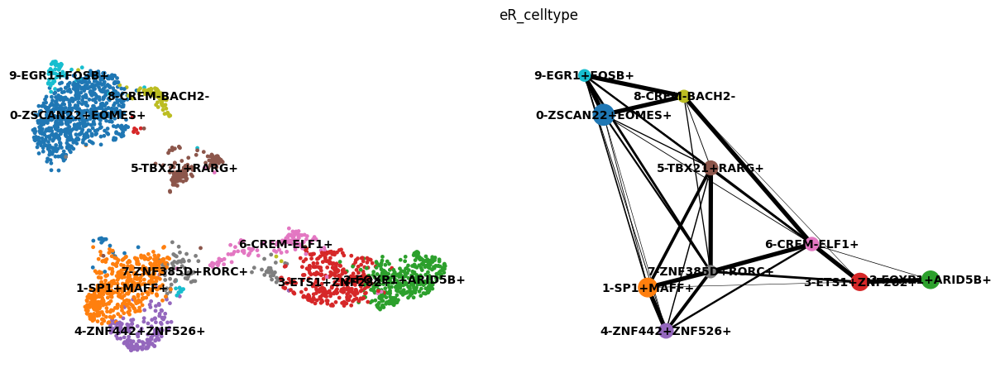

In [ ]:
# PAGA graph based on eR cell type
sc.tl.paga(adata, groups = 'eR_celltype')
sc.pl.paga_compare(adata, basis='eR_umap', color='eR_celltype', threshold=0.1, edge_width_scale = 0.5,save = 'paga_all_traj_plot_eR_umap_eR_celltype.pdf') # save path: thesis/GRN/figures

## Add embedding-based pseudotime

In [ ]:
# the sc.pl.diffmap function has some bug --> decomposed the get_embedding_dpt function here:
def get_embedding_dpt_modified(adata: AnnData,
                      group_var: str,
                      root_group: str,
                      embedding_key: Optional[str] = 'X_umap',
                      n_dcs: Optional[int] = 2, 
                      figsize: Optional[Tuple[float, float]] = (12,8),
                      palette: Optional[Dict] = None,
                      cmap: Optional[str] = 'viridis'):
    adata_h = adata
    #anndata.AnnData(X=pd.DataFrame(adata.obsm[embedding_key], index=adata.obs.index))
    adata_h.obs = adata.obs.copy()
    sc.pp.neighbors(adata_h, method='umap')
    adata_h.obs['clusters'] = adata_h.obs[group_var] 
    sc.tl.diffmap(adata_h, random_state=555, n_comps=3)
    #adata_h.obsm['X_diffmap'] = adata_h.obsm["X_diffmap"][:,1:]
    adata_h.uns['iroot'] = np.flatnonzero(adata_h.obs[group_var]  == root_group)[0]
    sc.tl.dpt(adata_h, n_dcs=n_dcs)
    adata_h.obs['distance'] = adata_h.obs['dpt_pseudotime']
    sc.pl.diffmap(adata_h, color=['clusters', 'distance'], legend_loc='on data', projection='2d', palette=palette)
    adata.obs['dpt_pseudotime'] = adata_h.obs['dpt_pseudotime'].copy()
    adata.obs['distance'] = adata.obs['dpt_pseudotime']
    adata.obs['clusters'] = adata.obs[group_var] 
    sc.pl.embedding(adata, embedding_key, color=['clusters', 'distance'], legend_loc='on data', cmap=cmap, palette=palette)

/Users/jinhuixin/miniconda3/envs/traj_sp_sc/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


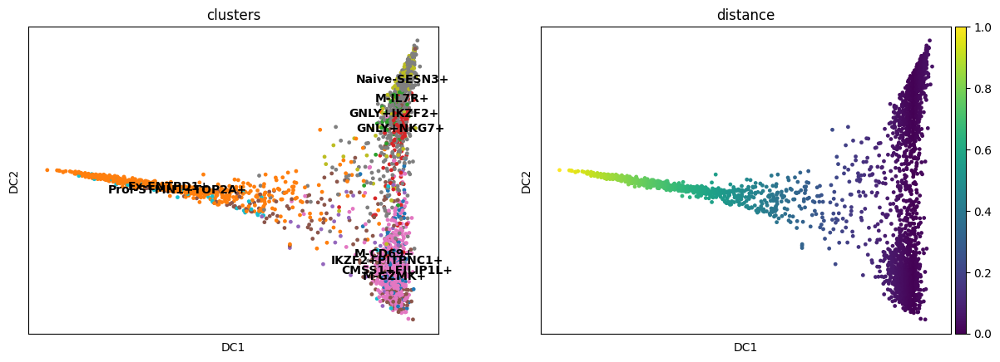

/Users/jinhuixin/miniconda3/envs/traj_sp_sc/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


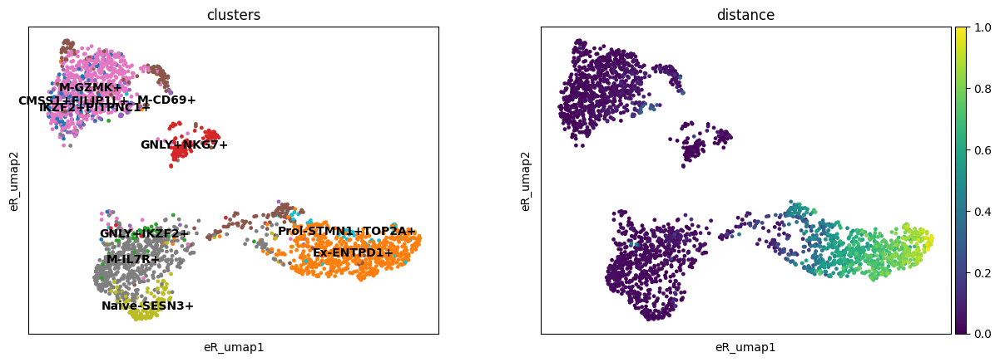

In [ ]:
# Choose the embedding we want to plot arrows in
# based on scRNA cell type here
adata.obs['Diff_state'] = adata.obs['rna_sct_celltype'].astype(str)
get_embedding_dpt_modified(adata, 'Diff_state', root_group='Naive-SESN3+', embedding_key='eR_umap', n_dcs=2, figsize=(12,8))

## Compare eR+rna based pseudotime and rna (multiom-umap) based pseudotime

the multiom-umap was based only on scRNA data

In [ ]:
# for comparison
def get_embedding_dpt_modified_comparison(adata: AnnData,
                      group_var: str,
                      root_group: str,
                      embedding_key: Optional[str] = 'X_umap',
                      n_dcs: Optional[int] = 2, 
                      figsize: Optional[Tuple[float, float]] = (12,8),
                      palette: Optional[Dict] = None,
                      cmap: Optional[str] = 'viridis'):
    adata_h = AnnData(X=pd.DataFrame(adata.obsm[embedding_key], index=adata.obs.index))
    adata_h.obs = adata.obs.copy()
    sc.pp.neighbors(adata_h, method='umap')
    adata_h.obs['clusters'] = adata_h.obs[group_var] 
    sc.tl.diffmap(adata_h, random_state=555, n_comps=3)
    #adata_h.obsm['X_diffmap'] = adata_h.obsm["X_diffmap"][:,1:]
    adata_h.uns['iroot'] = np.flatnonzero(adata_h.obs[group_var]  == root_group)[0]
    sc.tl.dpt(adata_h, n_dcs=n_dcs)
    adata_h.obs['distance'] = adata_h.obs['dpt_pseudotime']
    sc.pl.diffmap(adata_h, color=['clusters', 'distance'], legend_loc='on data', projection='2d', palette=palette)
    adata.obs['dpt_pseudotime'] = adata_h.obs['dpt_pseudotime'].copy()
    adata.obs['distance'] = adata.obs['dpt_pseudotime']
    adata.obs['clusters'] = adata.obs[group_var] 
    sc.pl.embedding(adata, 'eR_umap', color=['clusters', 'distance'], legend_loc='on data', cmap=cmap, palette=palette)

/var/folders/73/t_19bmpd5m7bnvd_88sxp6lw0000gn/T/ipykernel_32601/3938766846.py:10: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_h = AnnData(X=pd.DataFrame(adata.obsm[embedding_key], index=adata.obs.index))
/Users/jinhuixin/miniconda3/envs/traj_sp_sc/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


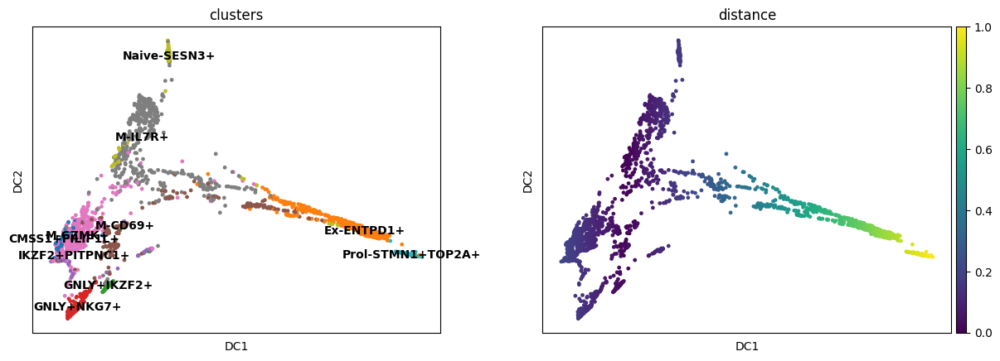

/Users/jinhuixin/miniconda3/envs/traj_sp_sc/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


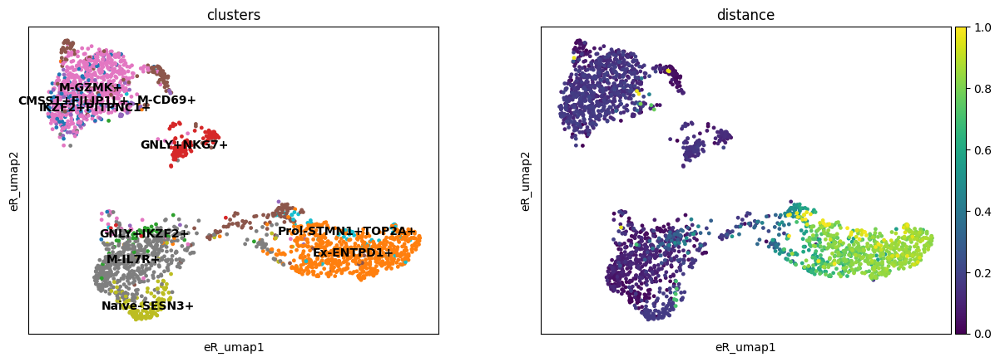

In [ ]:
adata.obs['Diff_state'] = adata.obs['rna_sct_celltype'].astype(str)
get_embedding_dpt_modified_comparison(adata, 'Diff_state', root_group='Naive-SESN3+', embedding_key='multiom_umap', n_dcs=2, figsize=(12,8))

## Comparison between RNA-celltype and eR-celltype

/Users/jinhuixin/miniconda3/envs/traj_sp_sc/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


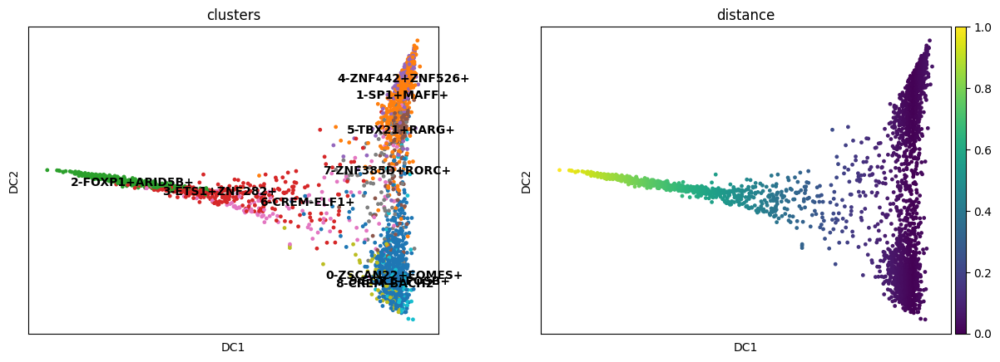

/Users/jinhuixin/miniconda3/envs/traj_sp_sc/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


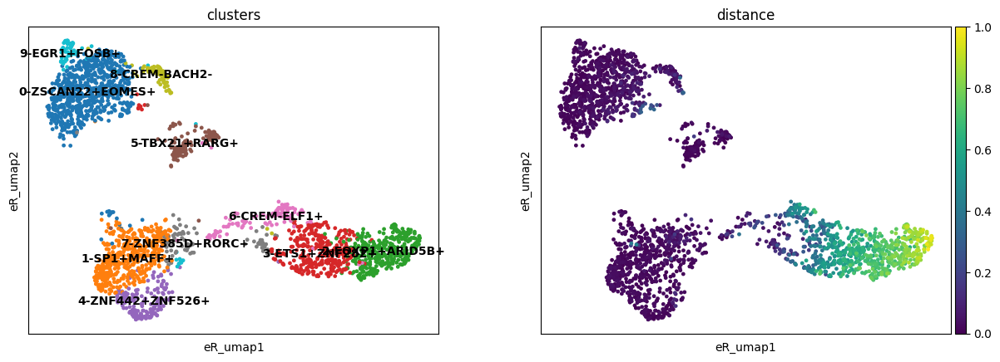

In [ ]:
adata.obs['Diff_state'] = adata.obs['eR_celltype'].astype(str)
get_embedding_dpt_modified(adata, 'Diff_state', root_group='4-ZNF442+ZNF526+', embedding_key='eR_umap', n_dcs=2, figsize=(12,8))

## Comparison between eR umap and RNA umap

/Users/jinhuixin/Downloads/scenicplus/src/scenicplus/differentiation_potential.py:56: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_h = anndata.AnnData(X=pd.DataFrame(adata.obsm[embedding_key], index=adata.obs.index))
/Users/jinhuixin/miniconda3/envs/traj_sp_sc/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


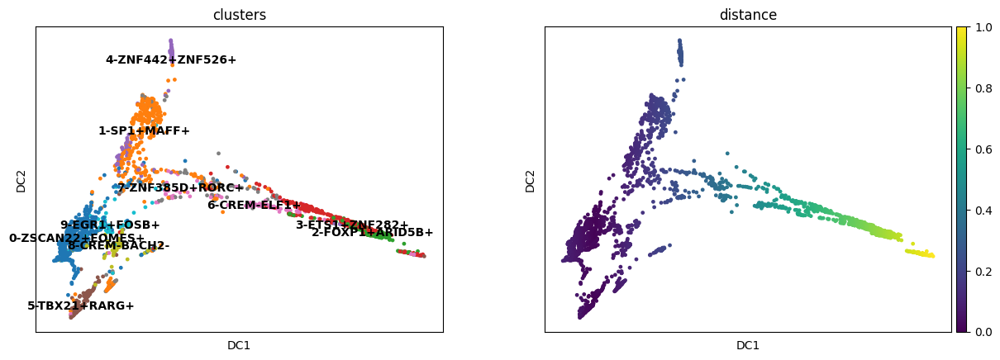

/Users/jinhuixin/miniconda3/envs/traj_sp_sc/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


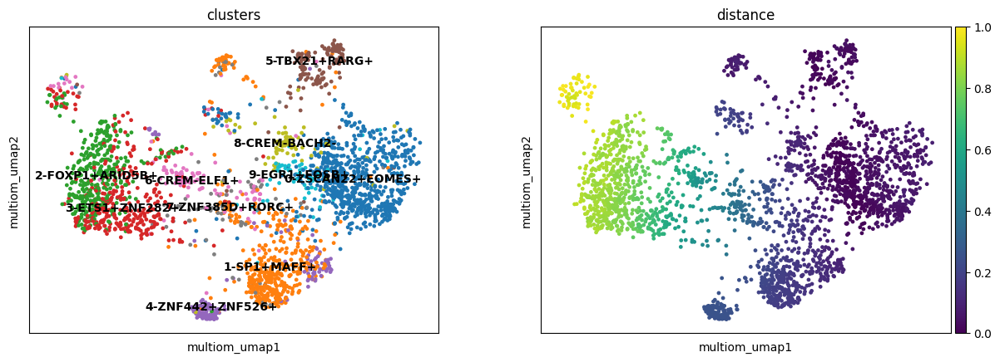

In [ ]:
from scenicplus.differentiation_potential import *
adata.obs['Diff_state'] = adata.obs['eR_celltype'].astype(str)
get_embedding_dpt(adata, 'Diff_state', root_group='4-ZNF442+ZNF526+', embedding_key='multiom_umap', n_dcs=2, figsize=(12,8))

/Users/jinhuixin/Downloads/scenicplus/src/scenicplus/differentiation_potential.py:56: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_h = anndata.AnnData(X=pd.DataFrame(adata.obsm[embedding_key], index=adata.obs.index))
/Users/jinhuixin/miniconda3/envs/traj_sp_sc/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


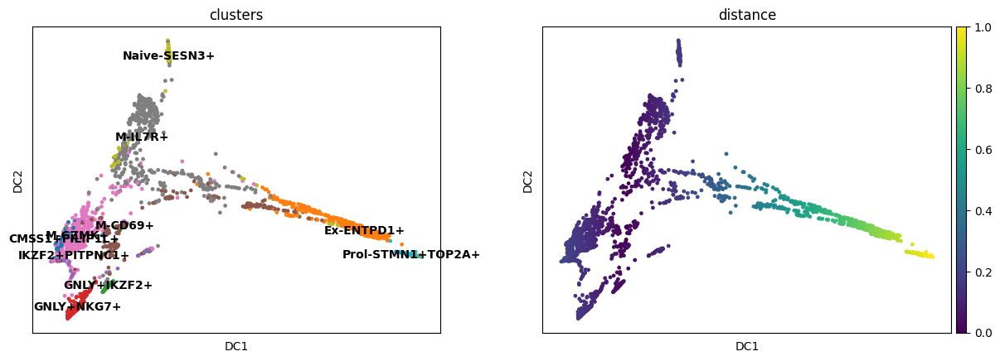

/Users/jinhuixin/miniconda3/envs/traj_sp_sc/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


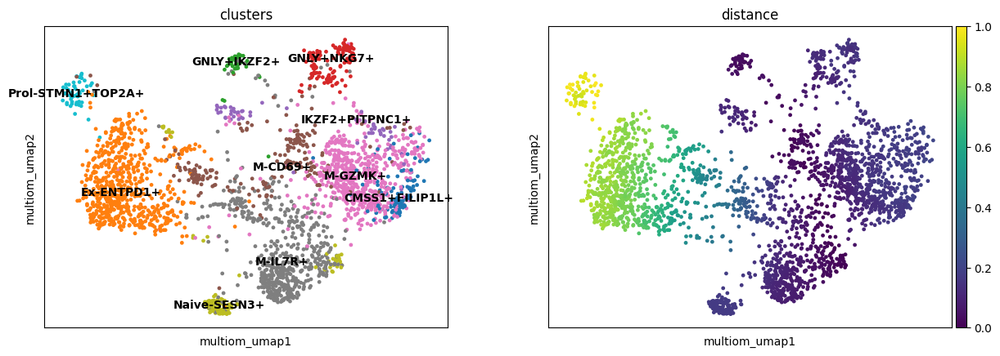

In [ ]:
from scenicplus.differentiation_potential import *
adata.obs['Diff_state'] = adata.obs['rna_sct_celltype'].astype(str)
get_embedding_dpt(adata, 'Diff_state', root_group='Naive-SESN3+', embedding_key='multiom_umap', n_dcs=2, figsize=(12,8))

In [ ]:
# Save
adata.write_h5ad(outDir+'EAD.h5ad')

# Inferring differentiation arrows (Tex)

we need to identify the changes in TF expression, target regions accessibility and target gene expression along the different paths using the get_path_matrix function.
we have to specify the paths and the cell types involved.

In [ ]:
# To read
import scanpy as sc
adata = sc.read_h5ad(outDir+'EAD.h5ad')

/Users/jinhuixin/miniconda3/envs/traj_sp_sc/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


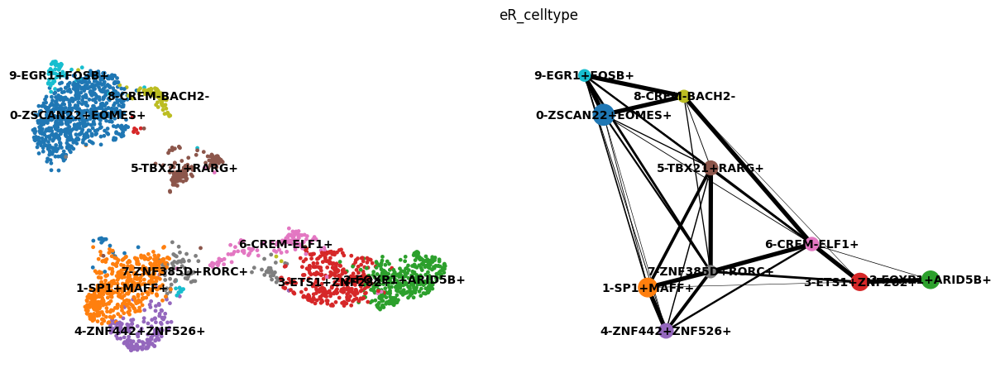

In [ ]:
sc.pl.paga_compare(adata, basis='eR_umap', color='eR_celltype', threshold=0.1, edge_width_scale = 0.5)

In [ ]:
set(adata.obs['eR_celltype'])

{'0-ZSCAN22+EOMES+',
 '1-SP1+MAFF+',
 '2-FOXP1+ARID5B+',
 '3-ETS1+ZNF282+',
 '4-ZNF442+ZNF526+',
 '5-TBX21+RARG+',
 '6-CREM-ELF1+',
 '7-ZNF385D+RORC+',
 '8-CREM-BACH2-',
 '9-EGR1+FOSB+'}

In [ ]:
# Set paths using the eR cell type
paths = [
    ('N2Ex',['4-ZNF442+ZNF526+','1-SP1+MAFF+', '7-ZNF385D+RORC+','5-TBX21+RARG+','6-CREM-ELF1+','3-ETS1+ZNF282+','2-FOXP1+ARID5B+']),
    ('N2M',['4-ZNF442+ZNF526+','1-SP1+MAFF+','5-TBX21+RARG+','0-ZSCAN22+EOMES+','8-CREM-BACH2-','9-EGR1+FOSB+']),
    ('M2Ex',['9-EGR1+FOSB+','0-ZSCAN22+EOMES+','8-CREM-BACH2-','5-TBX21+RARG+','6-CREM-ELF1+','3-ETS1+ZNF282+','2-FOXP1+ARID5B+'])
]

In [ ]:
adata.obs['Diff_state'] = adata.obs['eR_celltype'].astype(str)

In [ ]:
# Calculate path matrices
## Select path features
selected_features = {}
selected_features['TF'] = list(set([x.split('_')[0] for x in adata.var.index.tolist() if 'g)' in x]))
selected_features['Region'] = [x for x in adata.var.index.tolist() if 'r)' in x]
selected_features['Gene'] = [x for x in adata.var.index.tolist() if 'g)' in x]
## Calculate
from scenicplus.differentiation_potential import *
paths_cascade = {'TF':{}, 'Region':{}, 'Gene':{}}
for x in paths_cascade.keys():
    for ipath, (descr, path) in enumerate(paths):
        mat= get_path_matrix(
                adata, dpt_var = 'distance',
                path_var = 'Diff_state',
                path = path, features = selected_features[x],
                split_groups = True)
        paths_cascade[x][descr] = mat

In [ ]:
for i in enumerate(paths):
    print(i)

(0, ('N2Ex', ['4-ZNF442+ZNF526+', '1-SP1+MAFF+', '7-ZNF385D+RORC+', '5-TBX21+RARG+', '6-CREM-ELF1+', '3-ETS1+ZNF282+', '2-FOXP1+ARID5B+']))
(1, ('N2M', ['4-ZNF442+ZNF526+', '1-SP1+MAFF+', '5-TBX21+RARG+', '0-ZSCAN22+EOMES+', '8-CREM-BACH2-', '9-EGR1+FOSB+']))
(2, ('M2Ex', ['9-EGR1+FOSB+', '0-ZSCAN22+EOMES+', '8-CREM-BACH2-', '5-TBX21+RARG+', '6-CREM-ELF1+', '3-ETS1+ZNF282+', '2-FOXP1+ARID5B+']))


In [ ]:
top_eRs = pd.read_csv('../eRegulon_cluster/r&g_top_eR_in_eR_cluster.csv', index_col=0, header=None) # import the top eRs in each cluster
top_eRs = top_eRs.T
top_eRs.columns = ['0-ZSCAN22+EOMES+',
                    '1-SP1+MAFF+',
                    '2-FOXP1+ARID5B+',
                    '3-ETS1+ZNF282+',
                    '4-ZNF442+ZNF526+',
                    '5-TBX21+RARG+',
                    '6-CREM-ELF1+',
                    '7-ZNF385D+RORC+',
                    '8-CREM-BACH2-',
                    '9-EGR1+FOSB+']
top_eRs_dict = top_eRs.to_dict('list')
top_eRs_dict = {k:[elem for elem in v if elem is not np.nan] for k,v in top_eRs_dict.items()}

# Generate eR enrichment level along trajectories on eR umap

In [ ]:
# def a function
def eR_differentiation(eR:str, cell_type:str, adata = adata, paths_cascade = paths_cascade):
    fig, ax = plt.subplots(figsize =(12, 4))
    plt.subplot(1, 3, 1)
    df_1 = plot_potential(adata, paths_cascade, 'N2Ex', eR, window=1, gam_smooth=True, return_data = True)
    plt.subplot(1, 3, 2)
    df_2 = plot_potential(adata, paths_cascade, 'N2M', eR, window=1, gam_smooth=True, return_data = True)
    plt.subplot(1, 3, 3)
    df_2 = plot_potential(adata, paths_cascade, 'M2Ex', eR, window=1, gam_smooth=True, return_data = True)
    plt.tight_layout()
    if not os.path.exists(outDir + '/eR_celltype/' + cell_type):
        os.makedirs(outDir + '/eR_celltype/' + cell_type)
    plt.savefig(outDir+'/eR_celltype/'+ cell_type + '/curve_plot_' + eR + '.pdf')
    with rc_context({'figure.figsize': (10,5)}):
        arrow_plot_dir = outDir+'/eR_celltype/'+ cell_type + '/arrow_plot_' + eR + '.pdf' 
        plot_map(adata, paths_cascade, eR, color_var='Diff_state', embedding_key='eR_umap', n_grid_cols = 25, n_grid_rows = 25, offset_frac = 0.005,
                tf_traj_thr=0.7, tf_expr_thr=0.2, scale=50, figsize=(14,10), gam_smooth=True, save=arrow_plot_dir,legend_fontsize = 'x-small', n_cpu = 4)


### generate all top eRs arrow and curve plot in 0-9 cluster

In [ ]:
for cell_type in ['0-ZSCAN22+EOMES+',
                    '1-SP1+MAFF+',
                    '2-FOXP1+ARID5B+',
                    '3-ETS1+ZNF282+',
                    '4-ZNF442+ZNF526+',
                    '5-TBX21+RARG+',
                    '6-CREM-ELF1+',
                    '7-ZNF385D+RORC+',
                    '8-CREM-BACH2-',
                    '9-EGR1+FOSB+']:
    for eR in top_eRs_dict[cell_type]:
        if eR != 'PHF20_+' and eR != 'NR2F2_+': # these two eRs not available
            eR_differentiation(eR, cell_type)

## Focus on specific TF

### EOMES

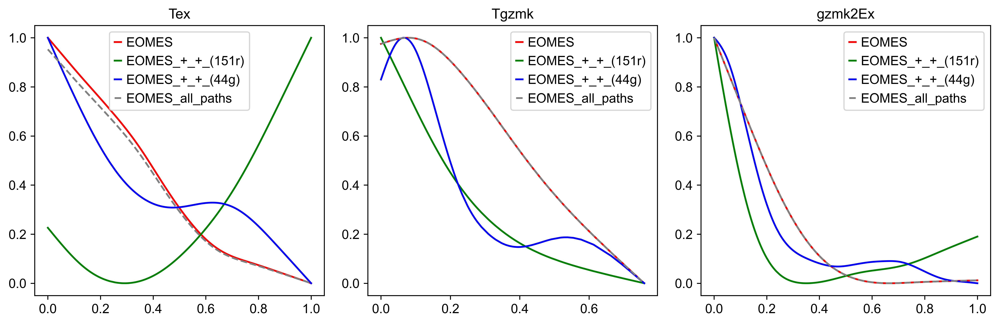

In [ ]:
# Plot changes along trajectory
# import os
# os.makedirs(outDir+'/curve_plots/')
fig, ax = plt.subplots(figsize =(12, 4))
plt.subplot(1, 3, 1)
df_1 = plot_potential(adata, paths_cascade, 'Tex', 'EOMES', window=1, gam_smooth=True, return_data = True)
plt.subplot(1, 3, 2)
df_2 = plot_potential(adata, paths_cascade, 'Tgzmk', 'EOMES', window=1, gam_smooth=True, return_data = True)
plt.subplot(1, 3, 3)
df_2 = plot_potential(adata, paths_cascade, 'gzmk2Ex', 'EOMES', window=1, gam_smooth=True, return_data = True)
plt.tight_layout()
plt.savefig(outDir+'/eR_umap/curve_plots/eomes.pdf')

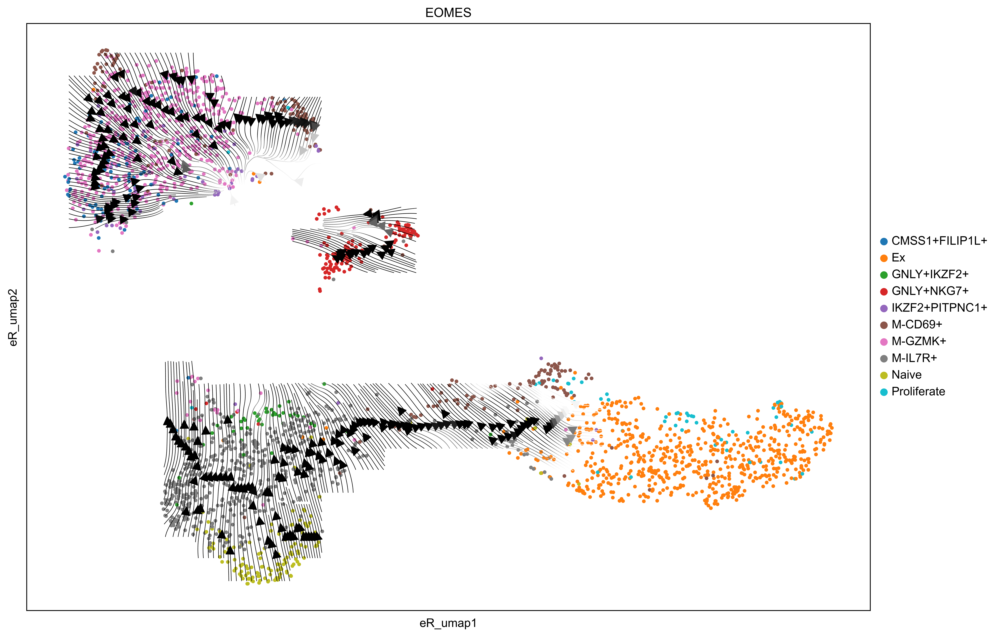

In [ ]:
#os.mkdir(outDir+'/arrow_plots')
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (14,10)}):
    plot_map(adata, paths_cascade, 'EOMES', color_var='Diff_state', embedding_key='eR_umap', n_grid_cols = 25, n_grid_rows = 25, offset_frac = 0.005,
             tf_traj_thr=0.7, tf_expr_thr=0.2, scale=50, figsize=(14,10), gam_smooth=True, save=outDir+'/arrow_plots/eomes+.pdf')

### TCF7

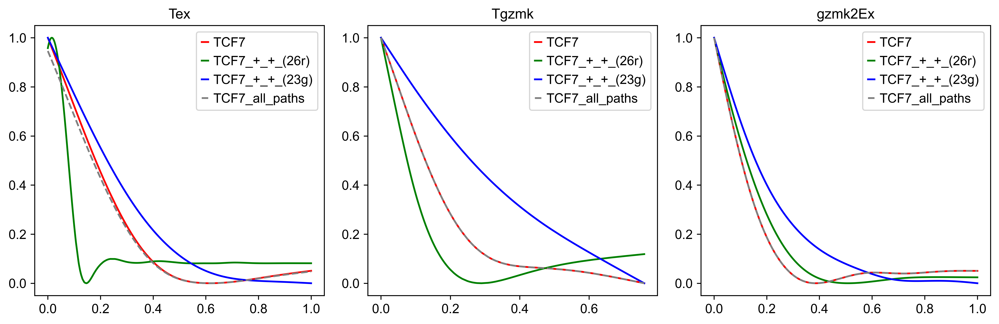

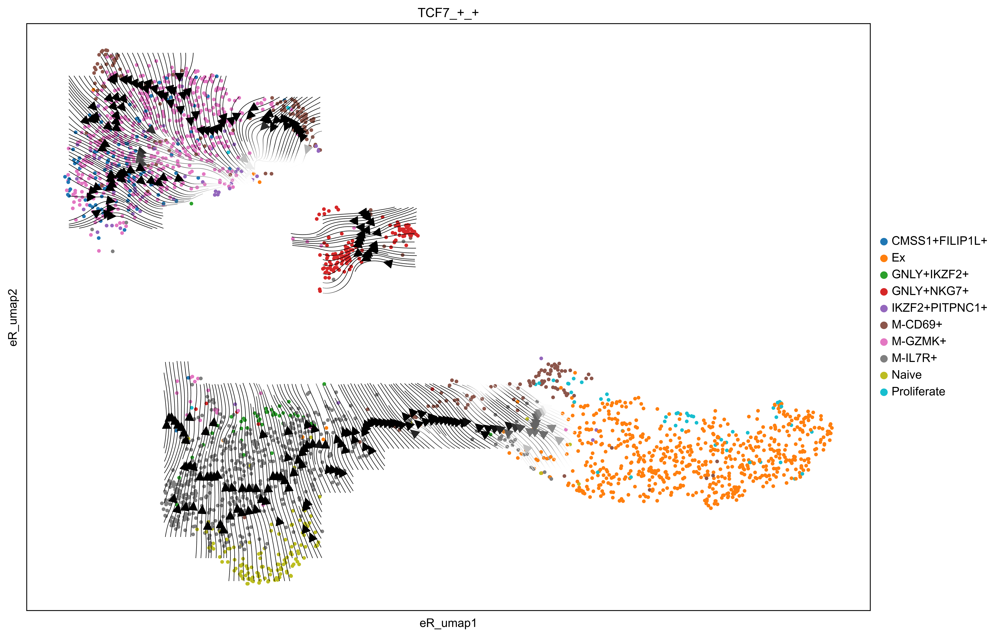

In [ ]:
# Plot changes along trajectory
# import os
# os.makedirs(outDir+'/curve_plots/')
fig, ax = plt.subplots(figsize =(12, 4))
plt.subplot(1, 3, 1)
df_1 = plot_potential(adata, paths_cascade, 'Tex', 'TCF7_+', window=1, gam_smooth=True, return_data = True)
plt.subplot(1, 3, 2)
df_2 = plot_potential(adata, paths_cascade, 'Tgzmk', 'TCF7_+', window=1, gam_smooth=True, return_data = True)
plt.subplot(1, 3, 3)
df_2 = plot_potential(adata, paths_cascade, 'gzmk2Ex', 'TCF7_+', window=1, gam_smooth=True, return_data = True)
plt.tight_layout()
plt.savefig(outDir+'/curve_plots/tcf7.pdf')
#os.mkdir(outDir+'/arrow_plots')
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (14,10)}):
    plot_map(adata, paths_cascade, 'TCF7_+_+', color_var='Diff_state', embedding_key='eR_umap', n_grid_cols = 25, n_grid_rows = 25, offset_frac = 0.005,
             tf_traj_thr=0.7, tf_expr_thr=0.2, scale=50, figsize=(14,10), gam_smooth=True, save=outDir+'/arrow_plots/tcf7++.pdf')

### KLF3

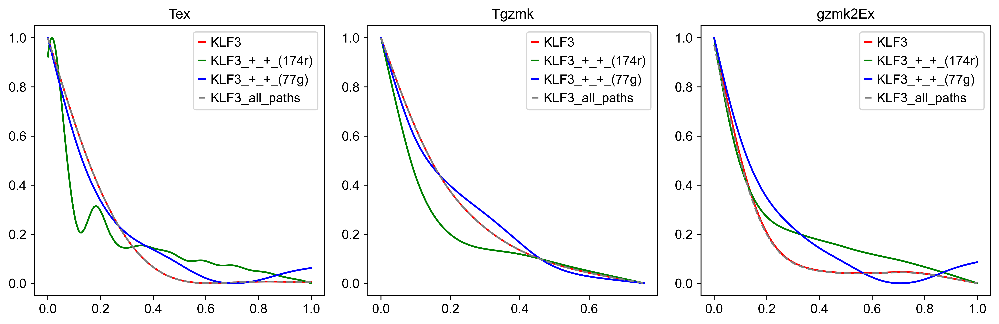

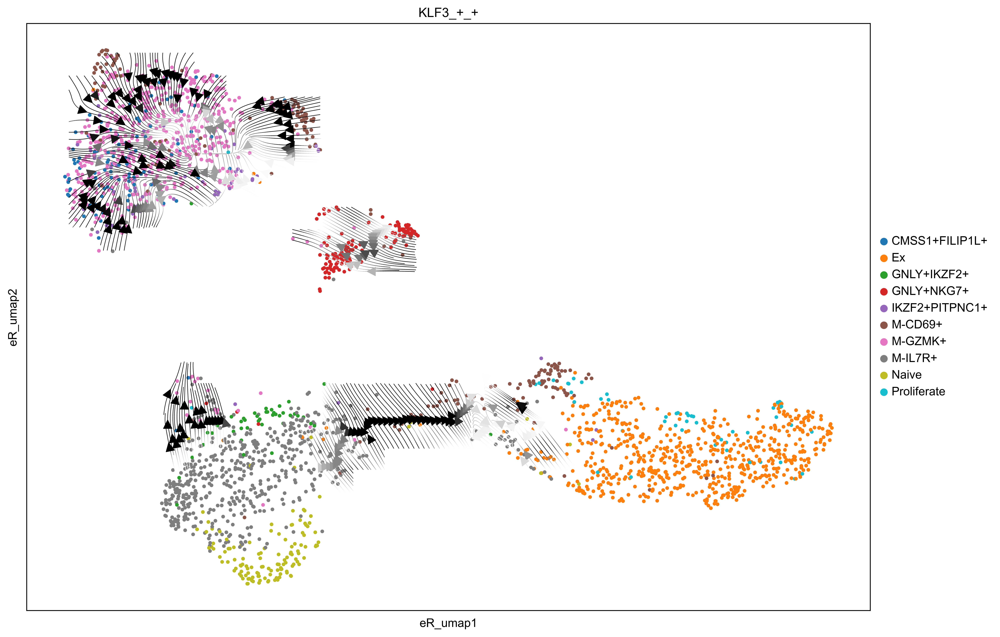

In [ ]:
# Plot changes along trajectory
# import os
# os.makedirs(outDir+'/curve_plots/')
fig, ax = plt.subplots(figsize =(12, 4))
plt.subplot(1, 3, 1)
df_1 = plot_potential(adata, paths_cascade, 'Tex', 'KLF3_+', window=1, gam_smooth=True, return_data = True)
plt.subplot(1, 3, 2)
df_2 = plot_potential(adata, paths_cascade, 'Tgzmk', 'KLF3_+', window=1, gam_smooth=True, return_data = True)
plt.subplot(1, 3, 3)
df_1 = plot_potential(adata, paths_cascade, 'gzmk2Ex', 'KLF3_+', window=1, gam_smooth=True, return_data = True)
plt.tight_layout()
plt.savefig(outDir+'/curve_plots/klf3.pdf')
#os.mkdir(outDir+'/arrow_plots')
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (14,10)}):
    plot_map(adata, paths_cascade, 'KLF3_+_+', color_var='Diff_state', embedding_key='eR_umap', n_grid_cols = 25, n_grid_rows = 25, offset_frac = 0.005,
             tf_traj_thr=0.7, tf_expr_thr=0.2, scale=50, figsize=(14,10), gam_smooth=True, save=outDir+'/arrow_plots/klf3++.pdf')

## NFKB1

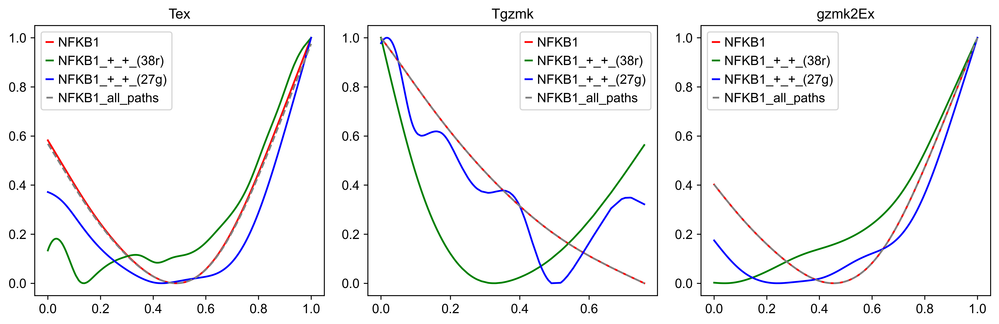

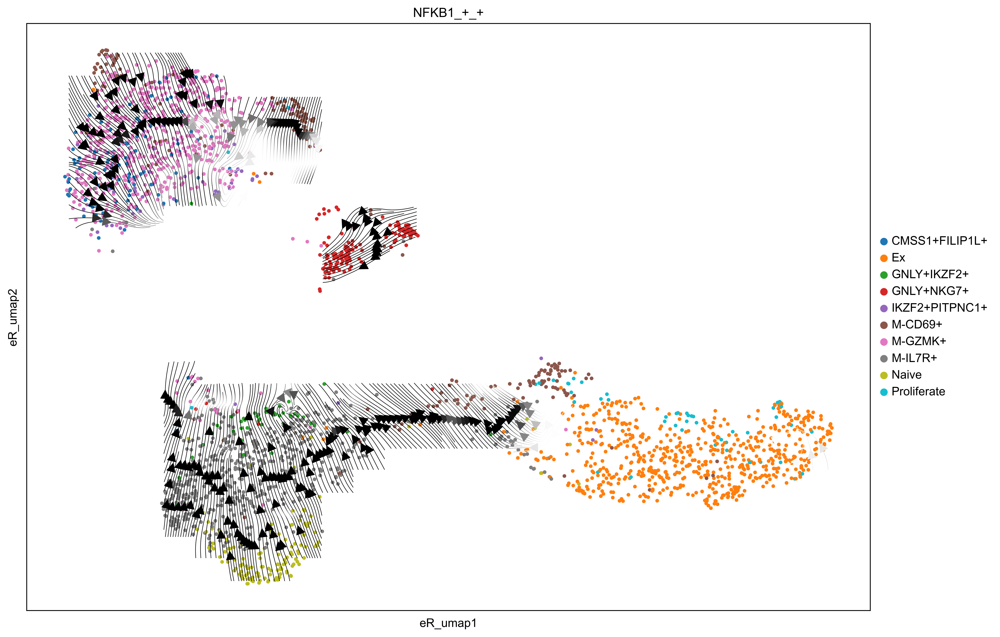

In [ ]:
# Plot changes along trajectory
# import os
# os.makedirs(outDir+'/curve_plots/')
fig, ax = plt.subplots(figsize =(12, 4))
plt.subplot(1, 3, 1)
df_1 = plot_potential(adata, paths_cascade, 'Tex', 'NFKB1_+', window=1, gam_smooth=True, return_data = True)
plt.subplot(1, 3, 2)
df_2 = plot_potential(adata, paths_cascade, 'Tgzmk', 'NFKB1_+', window=1, gam_smooth=True, return_data = True)
plt.subplot(1, 3, 3)
df_1 = plot_potential(adata, paths_cascade, 'gzmk2Ex', 'NFKB1_+', window=1, gam_smooth=True, return_data = True)
plt.tight_layout()
plt.savefig(outDir+'/curve_plots/nfkb1.pdf')
#os.mkdir(outDir+'/arrow_plots')
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (14,10)}):
    plot_map(adata, paths_cascade, 'NFKB1_+_+', color_var='Diff_state', embedding_key='eR_umap', n_grid_cols = 25, n_grid_rows = 25, offset_frac = 0.005,
             tf_traj_thr=0.7, tf_expr_thr=0.2, scale=50, figsize=(14,10), gam_smooth=True, save=outDir+'/arrow_plots/nfkb1++.pdf')

## GATA3 (naive)

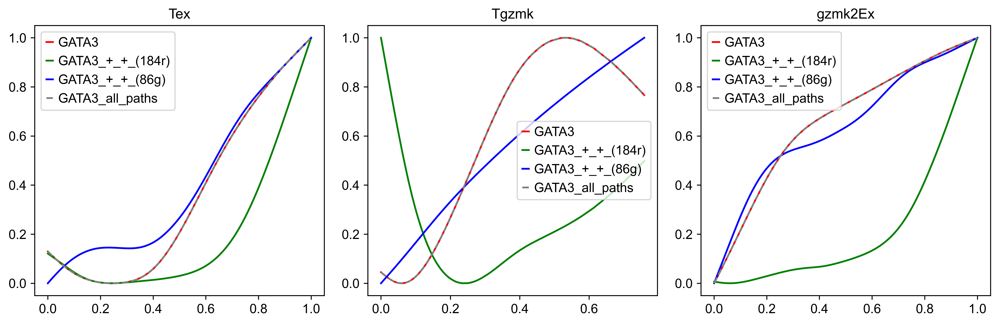

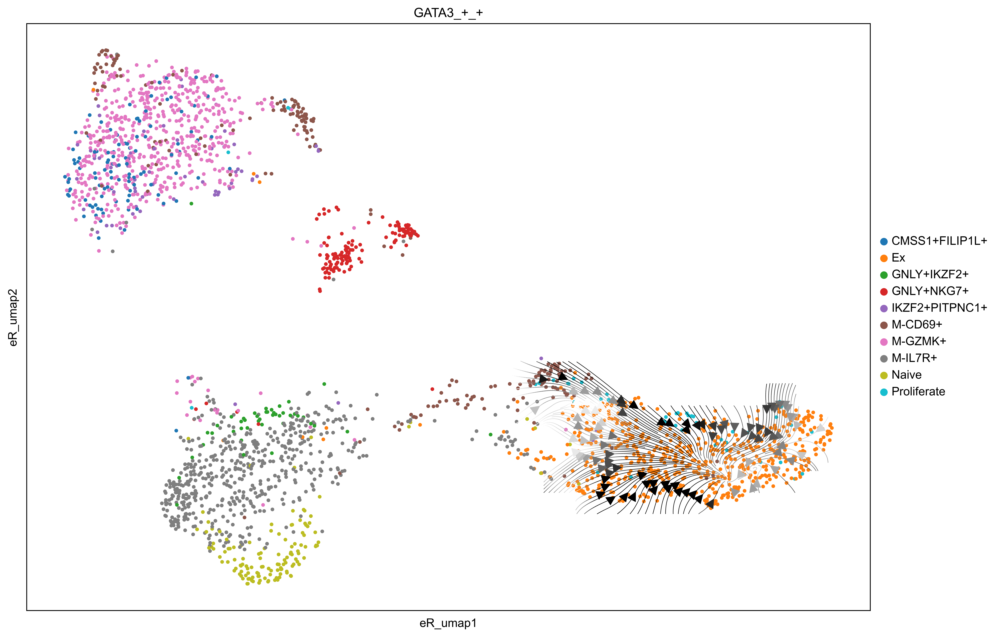

In [ ]:
# Plot changes along trajectory
# import os
# os.makedirs(outDir+'/curve_plots/')
fig, ax = plt.subplots(figsize =(12, 4))
plt.subplot(1, 3, 1)
df_1 = plot_potential(adata, paths_cascade, 'Tex', 'GATA3_+', window=1, gam_smooth=True, return_data = True)
plt.subplot(1, 3, 2)
df_2 = plot_potential(adata, paths_cascade, 'Tgzmk', 'GATA3_+', window=1, gam_smooth=True, return_data = True)
plt.subplot(1, 3, 3)
df_1 = plot_potential(adata, paths_cascade, 'gzmk2Ex', 'GATA3_+', window=1, gam_smooth=True, return_data = True)
plt.tight_layout()
plt.savefig(outDir+'/curve_plots/gata3.pdf')
#os.mkdir(outDir+'/arrow_plots')
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (14,10)}):
    plot_map(adata, paths_cascade, 'GATA3_+_+', color_var='Diff_state', embedding_key='eR_umap', n_grid_cols = 25, n_grid_rows = 25, offset_frac = 0.005,
             tf_traj_thr=0.7, tf_expr_thr=0.2, scale=50, figsize=(14,10), gam_smooth=True, save=outDir+'/arrow_plots/gata3++.pdf')

## RUNX1

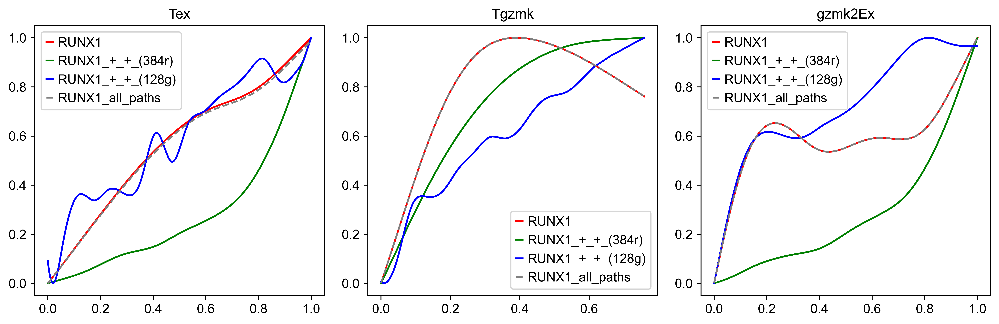

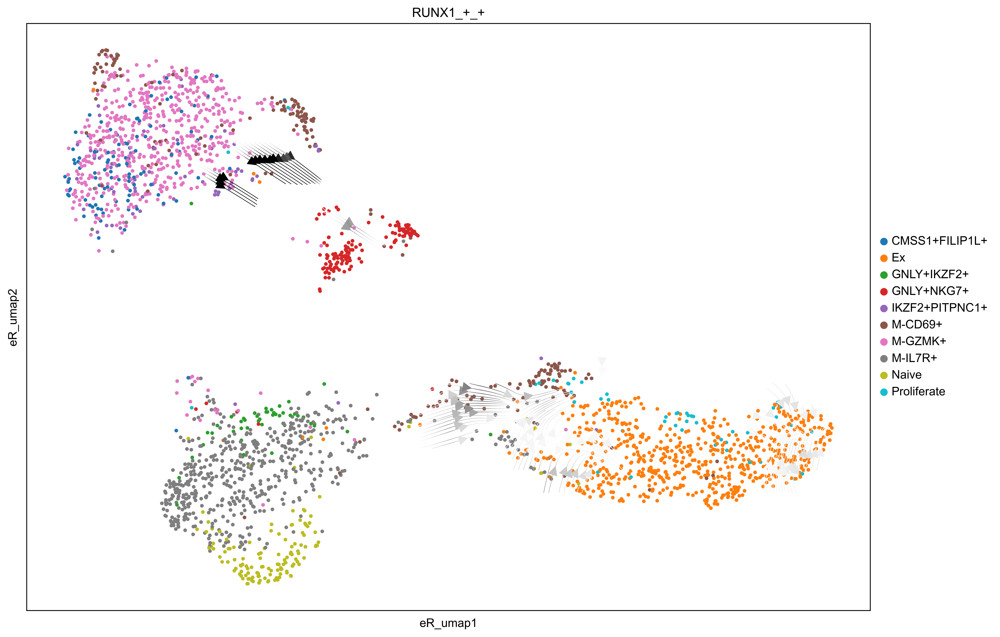

In [ ]:
# Plot changes along trajectory
# import os
# os.makedirs(outDir+'/curve_plots/')
fig, ax = plt.subplots(figsize =(12, 4))
plt.subplot(1, 3, 1)
df_1 = plot_potential(adata, paths_cascade, 'Tex', 'RUNX1_+', window=1, gam_smooth=True, return_data = True)
plt.subplot(1, 3, 2)
df_2 = plot_potential(adata, paths_cascade, 'Tgzmk', 'RUNX1_+', window=1, gam_smooth=True, return_data = True)
plt.subplot(1, 3, 3)
df_1 = plot_potential(adata, paths_cascade, 'gzmk2Ex', 'RUNX1_+', window=1, gam_smooth=True, return_data = True)
plt.tight_layout()
plt.savefig(outDir+'/curve_plots/runx1.pdf')
#os.mkdir(outDir+'/arrow_plots')
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (14,10)}):
    plot_map(adata, paths_cascade, 'RUNX1_+_+', color_var='Diff_state', embedding_key='eR_umap', n_grid_cols = 25, n_grid_rows = 25, offset_frac = 0.005,
             tf_traj_thr=0.7, tf_expr_thr=0.2, scale=50, figsize=(14,10), gam_smooth=True, save=outDir+'/arrow_plots/runx1++.pdf')